In [1]:
import os
# fpath = '/raid/lingo/akyurek/git/rfs-incremental'
# if os.getcwd() != fpath: os.chdir(fpath)
%matplotlib inline
import pandas as pd
from IPython.display import HTML
from IPython.display import Latex
from sklearn.metrics import multilabel_confusion_matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
# print(os.getcwd())

,idx,class,isbase,predicted,img
825,0,missile,False,tank,
826,0,missile,False,missile,
827,0,missile,False,missile,
828,0,missile,False,miniskirt,
829,0,missile,False,miniskirt,
830,0,white wolf,False,white wolf,
831,0,white wolf,False,spider web,
832,0,white wolf,False,white wolf,
833,0,white wolf,False,white wolf,
834,0,white wolf,False,white wolf,

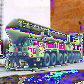
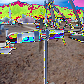
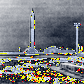
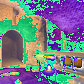
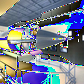
...
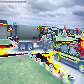
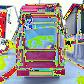
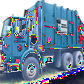
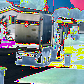
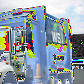

In [3]:

# %% Load Data
df = pd.read_csv("fine_tune_vis_regularize_0.0.csv")
df.columns
(df['class'] == df['predicted']).sum() / len(df)



# %%Displays Data Frame
HTML(df[-500:].to_html(escape=False))




In [12]:
import numpy as np

In [14]:
classes = np.unique(list(df['predicted']) + list(df['class']))
classes

array(['aircraft carrier', 'arctic fox', 'ashcan', 'barrel', 'clog',
       'dishrag', 'garbage truck', 'holster', 'miniskirt', 'missile',
       'newfoundland', 'organ', 'parallel bars', 'pencil box',
       'photocopier', 'poncho', 'snorkel', 'spider web', 'street sign',
       'tank', 'white wolf', 'worm fence', 'yawl'], dtype='<U16')

/home/gridsan/akyurek/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """


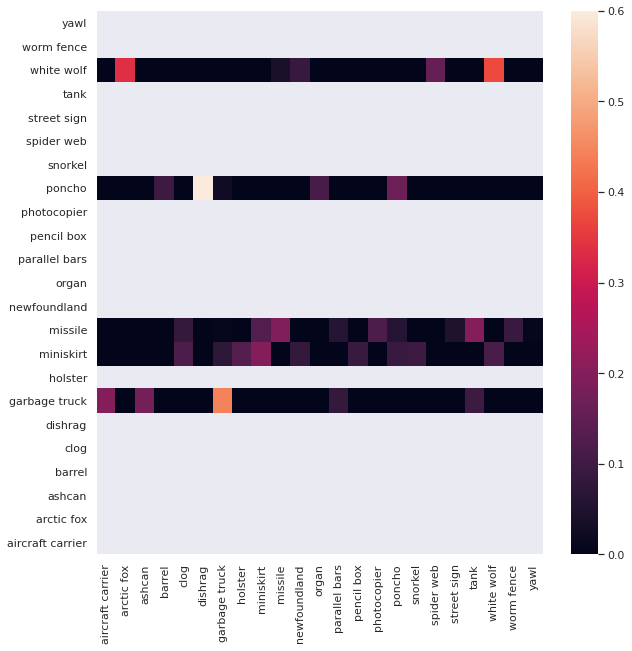

In [15]:
classes = np.unique(list(df['predicted']) + list(df['class']))

confusion = confusion_matrix(df.loc[-25:,'class'], df.loc[-25:,'predicted'], labels=classes)

confusion = confusion / confusion.sum(axis=1, keepdims=True)
confusion
sns.set(rc={'figure.figsize':(10,10)})
ax = sns.heatmap(confusion, annot=False, xticklabels=classes, yticklabels=classes).invert_yaxis()


,idx,class,isbase,predicted,img
625,0,missile,False,tank,
626,0,missile,False,parallel bars,
627,0,missile,False,yawl,
628,0,missile,False,miniskirt,
629,0,missile,False,photocopier,
630,0,white wolf,False,arctic fox,
631,0,white wolf,False,spider web,
632,0,white wolf,False,arctic fox,
633,0,white wolf,False,arctic fox,
634,0,white wolf,False,newfoundland,

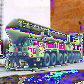
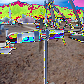
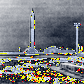
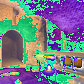
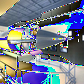
...
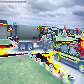
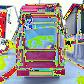
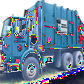
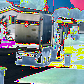
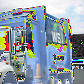

In [16]:

# %% Load Data
df = pd.read_csv("fine_tune_vis_regularize_0.05.csv")
df.columns
(df['class'] == df['predicted']).sum() / len(df)



# %%Displays Data Frame
HTML(df[-500:].to_html(escape=False))




In [17]:
classes = np.unique(list(df['predicted']) + list(df['class']))
classes

array(['aircraft carrier', 'arctic fox', 'ashcan', 'barrel', 'clog',
       'dishrag', 'garbage truck', 'holster', 'miniskirt', 'missile',
       'newfoundland', 'organ', 'parallel bars', 'pencil box',
       'photocopier', 'poncho', 'snorkel', 'spider web', 'street sign',
       'tank', 'white wolf', 'worm fence', 'yawl'], dtype='<U16')

/home/gridsan/akyurek/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


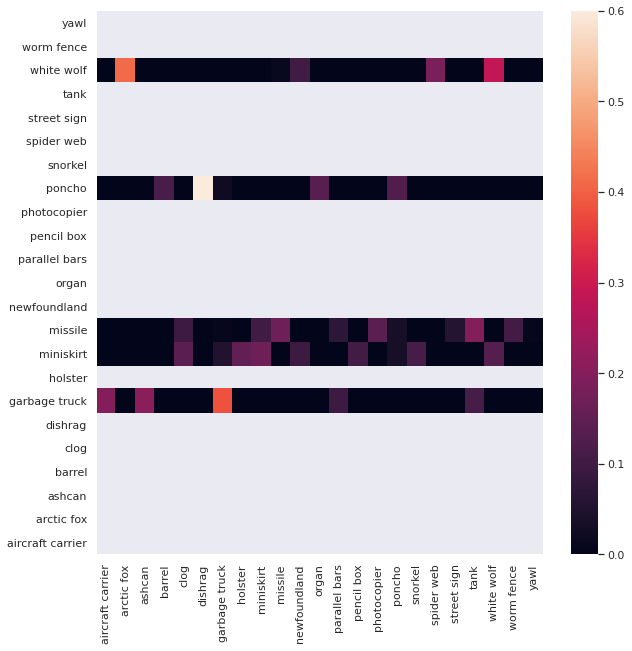

In [18]:
confusion = confusion_matrix(df.loc[-25:,'class'], df.loc[-25:,'predicted'], labels=classes)

confusion = confusion / confusion.sum(axis=1, keepdims=True)
confusion
sns.set(rc={'figure.figsize':(10,10)})
ax = sns.heatmap(confusion, annot=False, xticklabels=classes, yticklabels=classes).invert_yaxis()


In [19]:
import torch

In [20]:
DUMPED_PATH="/home/gridsan/akyurek/git/rfs-incremental/dumped"
# BACKBONE_PATH=DUMPED_PATH+"/backbones/linear/resnet12_miniImageNet_lr_0.05_decay_0.0005_trans_A_trial_pretrain_classifier_linear_8075566/resnet12_last.pth"
BACKBONE_PATH=DUMPED_PATH+"/backbonesLLs/linear/resnet12_miniImageNet_linear_classifier_wbias/resnet12_last.pth"
model = torch.load(BACKBONE_PATH)

RuntimeError: Attempting to deserialize object on a CUDA device but torch.cuda.is_available() is False. If you are running on a CPU-only machine, please use torch.load with map_location=torch.device('cpu') to map your storages to the CPU.